In [1]:
import sys
import time
import os
import subprocess
import math
import matplotlib.pyplot as plt
import numpy as np
from astropy.table import Table, Column 
from scipy.stats import linregress
from scipy import interpolate
from scipy import polyval, polyfit
from scipy.optimize import curve_fit
from scipy import odr
import pylab as py
from matplotlib import gridspec
import sklearn.datasets as ds
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression
import corner
import emcee
import scipy.optimize as op
from scipy.linalg import cholesky, inv,det
from scipy.optimize import minimize
import random
from astropy.table import Table, Column
import pandas as pd
import numpy as np
from datetime import datetime
import time

In [2]:
df = pd.read_csv('TFR_CF4_components_bar.csv', delimiter='|')
df["PGC1"] = df.apply(lambda x: x.PGC1 if x.PGC1 != 0 else x.PGC, axis=1)
df = df.set_index('PGC')

print(len(df))

df.head()

12569


,PGC1,Nest,Vcmb,Vmod,DM_av,eDM_av,av_flag,DM_cf4,eDM_cf4,cf4_flag,...,cf2_flag,DM_sfi,eDM_sfi,sfi_flag,DM_2mtf,eDM_2mtf,2mtf_flag,DM_flat,eDM_flat,flat_flag
PGC,,,,,,,,,,,,,,,,,,,,,
2,73150.0,200275.0,4726.0,4785.113640,34.240000,0.390000,0.0,34.24,0.39,0.0,...,0.0,0.000,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,120.0,202766.0,4109.0,4153.715722,33.386902,0.224574,0.0,33.29,0.37,0.0,...,0.0,33.518,0.39,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12,12.0,210177.0,6195.0,6296.413824,35.030000,0.390000,0.0,35.03,0.39,0.0,...,0.0,0.000,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16,16.0,211419.0,5312.0,5386.635077,34.700000,0.370000,0.0,34.70,0.37,0.0,...,0.0,0.000,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0
55,55.0,0.0,4454.0,4506.520342,34.177273,0.224574,0.0,34.00,0.37,0.0,...,0.0,34.398,0.39,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [3]:
leda = pd.read_csv('Leda_bar.csv', delimiter='|')
leda = leda.set_index('PGC')

print(len(leda))

leda.head()

133229


/home/ehsan/anaconda2/lib/python2.7/site-packages/IPython/core/interactiveshell.py:2714: DtypeWarning: Columns (69,70,71,72,73,74,75,76) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,DEC2000,RA2000,al1950,de1950,al2000,de2000,l2,b2,sgl,sgb,...,mod0,mabs,objname,objtype,type,bar,ring,multiple,compactness,angclass
PGC,,,,,,,,,,,,,,,,,,,,,
1,4206.0,235958.8,23.95695,0.42327,23.99966,0.70168,96.87946,-59.54180,293.35019,13.43002,...,NaN,-21.94,PGC000001,G,S?,NaN,NaN,NaN,NaN,NaN
2,471628.2,1.7,23.95786,46.99616,0.00047,47.27450,113.95535,-14.69916,341.64403,20.73880,...,NaN,-21.10,UGC12889,G,Sb,B,NaN,NaN,NaN,NaN
4,230515.5,3.5,23.95829,22.80927,0.00096,23.08764,107.83219,-38.27289,316.05865,18.45140,...,NaN,-18.72,PGC000004,G,Sc,NaN,NaN,NaN,NaN,NaN
5,324418.2,9.1,23.95988,32.46003,0.00254,32.73839,110.62060,-28.90431,326.17705,19.78055,...,NaN,-21.43,IC5370,G,S0-a,NaN,NaN,NaN,NaN,NaN
6,155253.9,2.1,23.95790,15.60327,0.00058,15.88165,105.25252,-45.21822,308.62424,17.10314,...,NaN,-19.49,PGC000006,G,S0-a,NaN,NaN,NaN,C,NaN


In [4]:
how = 'inner'

df = df.join(leda, lsuffix='_cf4', rsuffix='_leda', how=how)
df = df[["PGC1", "Vcmb", "sgl", "sgb"]]

# df.sort_values(by=['PGC1'])

print(len(df))

df.head()

12569


,PGC1,Vcmb,sgl,sgb
PGC,,,,
2,73150.0,4726.0,341.64403,20.73880
4,120.0,4109.0,316.05865,18.45140
12,12.0,6195.0,286.42487,11.35107
16,16.0,5312.0,287.61198,11.70296
55,55.0,4454.0,327.09965,19.77625


In [5]:
dg = df.groupby('PGC1').agg(["mean", "count"])

dg.head()

Vcmb              sgl             sgb      
         mean count       mean count      mean count
PGC1                                                
12.0   6195.0     1  286.42487     1  11.35107     1
14.0  10883.0     1  300.97120     1  16.09477     1
16.0   5312.0     1  287.61198     1  11.70296     1
55.0   4454.0     1  327.09965     1  19.77625     1
63.0   8166.0     1  321.61600     1  19.67373     1

In [6]:
dg.loc[12].Vcmb['count']

1.0

In [7]:
df["Vgrp"] = df["PGC1"].apply(lambda x: dg.loc[x].Vcmb['mean'])
df["Ngrp"] = df["PGC1"].apply(lambda x: dg.loc[x].Vcmb['count'])

df.head()

,PGC1,Vcmb,sgl,sgb,Vgrp,Ngrp
PGC,,,,,,
2,73150.0,4726.0,341.64403,20.73880,4735.5,2.0
4,120.0,4109.0,316.05865,18.45140,4272.0,3.0
12,12.0,6195.0,286.42487,11.35107,6195.0,1.0
16,16.0,5312.0,287.61198,11.70296,5312.0,1.0
55,55.0,4454.0,327.09965,19.77625,4454.0,1.0


In [8]:
df = df.sort_values(by=['Vgrp', 'PGC1'], ascending=False)

df.head(20)

,PGC1,Vcmb,sgl,sgb,Vgrp,Ngrp
PGC,,,,,,
2800820,2800820.0,28349.0,144.62109,-7.97554,28349.0,1.0
1907590,1907590.0,28127.0,52.83887,-38.36889,28127.0,1.0
1103145,1103145.0,27021.0,294.75079,-1.50776,27021.0,1.0
153909,153909.0,26659.0,97.27822,-50.59691,26659.0,1.0
6849,6849.0,25666.0,331.97373,-2.78756,25666.0,1.0
61184,61083.0,24369.0,32.59819,35.67608,25187.5,10.0
166802,61083.0,25262.0,32.67724,35.88394,25187.5,10.0
166803,61083.0,24446.0,32.58802,35.88429,25187.5,10.0
166804,61083.0,24342.0,32.59186,35.95249,25187.5,10.0


In [9]:
import sys
import os
import random
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import  lines
from matplotlib import rc, rcParams
from matplotlib.ticker import MultipleLocator, FormatStrFormatter
from matplotlib.patches import Polygon, Ellipse
import numpy as np
from math import *
from time import time
import wl_to_rgb as col
import random
from astropy.io import ascii
from astropy.table import Table, Column 
import pyfits
import pylab as py
from astropy import coordinates as coord
from astropy import units as unit
import matplotlib.colors as colors
import matplotlib.cm as cmx
import matplotlib.patches as mpatches

from matplotlib import *

In [442]:
vel = df.Vcmb.values
vel = df.Vgrp.values

# vel = (vel-np.min(vel)) / (np.max(vel)-np.min(vel)) + 1
# vel = np.log10(vel)
# Mvel = np.median(vel)
# vel = vel / Mvel / 2.

print np.min(vel), np.max(vel)


-117.0 28349.0


(array([2102., 4106., 3437., 1981.,  646.,  164.,   90.,   21.,   17.,
           5.]),
 array([ -117. ,  2729.6,  5576.2,  8422.8, 11269.4, 14116. , 16962.6,
        19809.2, 22655.8, 25502.4, 28349. ]),
 <a list of 10 Patch objects>)

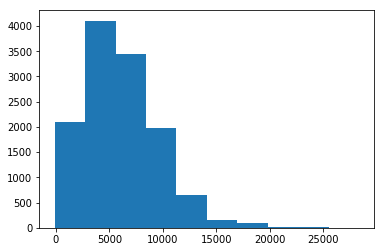

In [443]:
plt.hist(vel)

In [444]:
noaxis=dict(showbackground=False,
            showgrid=False,
            showline=False,
            showticklabels=False,
            ticks='',
            title='',
            zeroline=False,
            range=[-1.05, 1.05],
            showspikes=False,
           )

layout3d=dict(title='CF4 TF catalogs<br>Super-Galactic Projection',
              font=dict(family='Balto', size=14),
              width=800, 
              height=800,
              scene=dict(xaxis=noaxis, 
                         yaxis=noaxis, 
                         zaxis=noaxis,
                         aspectratio=dict(x=1,
                                          y=1,
                                          z=1),
                         camera=dict(eye=dict(x=1.0, 
                                     y=1.0, 
                                     z=1.0)
                                    )
            ),
            paper_bgcolor='rgba(250,250,250, 0.9)',
            hovermode = 'closest',
            hoverdistance = 50
           )

In [445]:
def degree2radians(degree):
    #convert degrees to radians
    return degree*pi/180

from numpy import pi, sin, cos


def mapping_map_to_sphere(lon, lat, radius=1):
    #this function maps the points of coords (lon, lat) to points onto the  sphere of radius radius
    
    lon=np.array(lon, dtype=np.float64)
    lat=np.array(lat, dtype=np.float64)
    lon=degree2radians(lon)
    lat=degree2radians(lat)
    xs=radius*cos(lon)*cos(lat)
    ys=radius*sin(lon)*cos(lat)
    zs=radius*sin(lat)
    return xs, ys, zs


In [446]:
xs, ys, zs=mapping_map_to_sphere(360.-df['sgl'], df['sgb'], radius=1.02)# here the radius is slightly greater than 1 
                                                         #to ensure lines visibility; otherwise (with radius=1)
                                                         # some lines are hidden by contours colors

In [447]:
import plotly.offline as py
import numpy as np           
from scipy.io import netcdf  
from mpl_toolkits.basemap import Basemap
import warnings
import plotly.graph_objects as go
import plotly.express as px

In [448]:
# col_pallet = ['darkviolet', 'blue', 'deepskyblue', 'forestgreen', 'yellow', 'gold', 'darkorange', 'red', 'magenta', 'maroon', 'sienna', 'slategrey', 'black']
# vel_pallet = [-100000, 1000, 2000, 3000, 4000, 5000, 6000, 7000, 8000, 9000, 10000, 12000, 15000, 20000]

col_pallet = ['darkviolet', 'blue', 'deepskyblue', 'forestgreen', 'gold', 'darkorange', 'red', 'sienna', 'maroon', 'black']
vel_pallet = [-100000, 0, 2000, 4000, 6000, 8000, 10000, 12000, 14000, 16000, 200000]

def color_table(Velocity):
    colours = []
    for j, v in enumerate(Velocity):
        col = "white"
        for i in range(len(vel_pallet)-1):
            if vel_pallet[i] <= v and v < vel_pallet[i+1]:
                col = col_pallet[i]
                break
        colours.append(col)
    return colours

colours = color_table(df.Vgrp.values)

In [449]:
deg = 1
a = pyfits.open('EBV.1.deg.fits')
d = a[1].data


SGL_org  = d['SGL']
SGB_org  = d['SGB']
EBV = d['EBV']



In [450]:
r = 300

SGL = np.linspace(-180, 180, r, endpoint=True)
SGB = np.linspace(-90, 90, r, endpoint=True)

SGL, SGB = np.meshgrid(SGL,SGB)
SGL = SGL.ravel()
SGB = SGB.ravel()

XS, YS, ZS = mapping_map_to_sphere(360.-SGL, SGB)# here the radius is slightly greater than 1 
                                                         #to ensure lines visibility; otherwise (with radius=1)
                                                         # some lines are hidden by contours colors

In [451]:
from astrometry.libkd import spherematch
from astrometry.util.starutil_numpy import *

m1, m2, distance = spherematch.match_radec(SGL, SGB, SGL_org, SGB_org, 5, 
                                           notself = True,
                                           nearest = True)

In [452]:
text = ['PGC: '+"%d"%df.index.values[j]+'<br>SGL: '+'{:.2f}'.format(df['sgl'].values[j])+
      '<br>SGB: '+'{:.2f}'.format(df['sgb'].values[j])+
        '<br>Vcmb: '+'%d'%df['Vcmb'].values[j]+
        '<br>Vgrpup: '+'%d'%df['Vgrp'].values[j]
       for j in range(len(df))]

scatter = go.Scatter3d(
   x = xs, y = ys, z = zs, mode = 'markers', marker = dict(
      size = 1,
      color = colours,
      ),
    text=text,
    hoverinfo='text'
   )




boundaries = []

lat0 = -80
while True:
    lon = np.linspace(-180, 180, 50, endpoint=True)
    lat = lon*0.+lat0
    xb, yb, zb = mapping_map_to_sphere(lon, lat, radius=1.01)
    
    col = 'gray'
    if lat0==0:
        col='black'
    boundaries.append(dict(type='scatter3d',
                   x=xb,
                   y=yb,
                   z=zb,
                   mode='lines',
                   line=dict(color=col, width=1), hoverinfo='skip'
                  ))
    lat0 += 20
    if lat0 > 90:
        break

lon0 = 0
while True:
    lat = np.linspace(-80, 80, 50, endpoint=True)
    lon = lat*0+lon0
    xb, yb, zb = mapping_map_to_sphere(lon, lat, radius=1.01)
    col = 'gray'
    if lon0==0:
        col='black'
    boundaries.append(dict(type='scatter3d',
                   x=xb,
                   y=yb,
                   z=zb,
                   mode='lines',
                   line=dict(color=col, width=1), hoverinfo='skip'
                  ))
    lon0 += 20
    if lon0 > 350:
        break


labels = []

sgl_txt = np.arange(0,360,20)
sgb_txt = sgl_txt*0.
xl, yl, zl = mapping_map_to_sphere(sgl_txt, sgb_txt, radius=1.02)
labels.append(go.Scatter3d(
    x=xl,
    y=yl,
    z=zl,
    text=["%d"%(360-txt) if txt!=0 else "0" for txt in sgl_txt],
    textposition="bottom center", 
    mode="markers+text",
    name="Markers and Text",
    marker = dict(
      size = 0.1,
      color = 'black',
      )
))



sgb_txt = np.arange(-80,0,20)
sgl_txt = sgb_txt*0.+20
xl, yl, zl = mapping_map_to_sphere(sgl_txt, sgb_txt, radius=1.02)
labels.append(go.Scatter3d(
    x=xl,
    y=yl,
    z=zl,
    text=["%d"%np.abs(txt)+'S' for txt in sgb_txt],
    textposition="bottom center", 
    mode="markers+text",
    name="Markers and Text",
    marker = dict(
      size = 0.1,
      color = 'black',
      )
))


sgb_txt = np.arange(20,90,20)
sgl_txt = sgb_txt*0.+20
xl, yl, zl = mapping_map_to_sphere(sgl_txt, sgb_txt, radius=1.02)
labels.append(go.Scatter3d(
    x=xl,
    y=yl,
    z=zl,
    text=["%d"%np.abs(txt)+'N' for txt in sgb_txt],
    textposition="bottom center", 
    mode="markers+text",
    name="Markers and Text",
    marker = dict(
      size = 0.1,
      color = 'black',
      )
))
        

sgb_txt = np.arange(-80,0,20)
sgl_txt = sgb_txt*0.+200
xl, yl, zl = mapping_map_to_sphere(sgl_txt, sgb_txt, radius=1.02)
labels.append(go.Scatter3d(
    x=xl,
    y=yl,
    z=zl,
    text=["%d"%np.abs(txt)+'S' for txt in sgb_txt],
    textposition="bottom center", 
    mode="markers+text",
    name="Markers and Text",
    marker = dict(
      size = 0.1,
      color = 'black',
      )
))


sgb_txt = np.arange(20,90,20)
sgl_txt = sgb_txt*0.+200
xl, yl, zl = mapping_map_to_sphere(sgl_txt, sgb_txt, radius=1.02)
labels.append(go.Scatter3d(
    x=xl,
    y=yl,
    z=zl,
    text=["%d"%np.abs(txt)+'N' for txt in sgb_txt],
    textposition="bottom center", 
    mode="markers+text",
    name="Markers and Text",
    marker = dict(
      size = 0.1,
      color = 'black',
      )
))    
    
        
fig = go.Figure(data = [scatter]+boundaries+labels, layout = layout3d)


fig.add_trace(go.Surface(x=XS.reshape(r,r), y=YS.reshape(r,r), z=ZS.reshape(r,r),
    contours=go.surface.Contours(
        x=go.surface.contours.X(
            highlight=False,
        ),
        y=go.surface.contours.Y(highlight=False),
        z=go.surface.contours.Z(highlight=False),
    ),
         colorscale=colorscale, surfacecolor=EBV[m2].reshape(r,r), 
         colorbar=dict(thickness=20, len=0.75, ticklen=4, title= 'E(B-V)'),
         cmin=0, cmax=2, hoverinfo='skip'))






fig.update_layout(showlegend=False)




py.iplot(fig)

fig.write_html("test.html")

In [453]:
np.arange(-80,100,20)

array([-80, -60, -40, -20,   0,  20,  40,  60,  80])